Base Algorithm

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import plotly.io as pio
import itertools
import pandas as pd
from copy import deepcopy


In [8]:


class Parameters_class:
    def __init__(self, b1, b2, alpha11, alpha22, alpha12, alpha21, z_m1_initial, z_m2_initial, initial_population_species_1, initial_population_species_2, cost_to_males, strength_of_interference, V_A1, V_A2, num_generations):
        self.b1 = b1
        self.b2 = b2

        self.alpha11 = alpha11
        self.alpha22 = alpha22
        self.alpha12 = alpha12
        self.alpha21 = alpha21
   
        self.z_m1_initial = z_m1_initial
        self.z_m2_initial = z_m2_initial

        self.initial_population_species_1 = initial_population_species_1
        self.initial_population_species_2 = initial_population_species_2

        self.cost_to_males = cost_to_males
        
        self.strength_of_interference = strength_of_interference

        self.V_A1 = V_A1
        self.V_A2 = V_A2
        # self.intraspecific_competition = intraspecific_competition

        self.num_generations = num_generations

class Simulation:
    def __init__(self, parameters):
        self.parameters = parameters
        self.population_species_history_1 = [parameters.initial_population_species_1]
        self.population_species_history_2 = [parameters.initial_population_species_2]
        self.z_m1_history = [parameters.z_m1_initial]
        self.z_m2_history = [parameters.z_m2_initial]
        self.z_m1 = parameters.z_m1_initial
        self.z_m2 = parameters.z_m2_initial

    def next_generation_ecology(self):
        N1 = self.population_species_history_1[-1]
        N2 = self.population_species_history_2[-1]
      
    
        if N1 > 0.01:
            next_N1 = (N1 / (N1 + self.parameters.strength_of_interference* (1 - self.z_m2) * N2)) * (self.parameters.b1 * N1 / (1 + self.parameters.alpha11 * N1 + self.parameters.alpha12 * N2))
            next_N1 = max(next_N1, 0)
        else:
            next_N1 = 0

        if N2 > 0.01:
            next_N2 = (N2 / (N2 + self.parameters.strength_of_interference * (1 - self.z_m1) * N1)) * (self.parameters.b2 * N2 / (1 + self.parameters.alpha22 * N2 + self.parameters.alpha21 * N1))
            next_N2 = max(next_N2, 0)
        else:
            next_N2 = 0

        self.population_species_history_1.append(next_N1)
        self.population_species_history_2.append(next_N2)

    def next_generation_traits(self, N1, N2):
        if N1 > 0.01:
            W_m1 = 1 - (self.parameters.cost_to_males * (1 - self.z_m1) * (N2 / (N2 + N1)))
            dW_m1_dz_m2 = self.parameters.cost_to_males * (N2 / (N2 + N1))
            delta_z_m1 = self.parameters.V_A1 * (1 / W_m1) * dW_m1_dz_m2
            new_z_m1 = self.z_m1 + delta_z_m1
            
            if new_z_m1 <= 1:
                self.z_m1 = new_z_m1
            else:
                self.z_m1 = 1

            self.z_m1_history.append(self.z_m1)

        if N2 > 0.01:
            W_m2 = 1 - (self.parameters.cost_to_males * (1 - self.z_m2) * (N2 / (N2 + N1)))
            dW_m2_dz_m2 = self.parameters.cost_to_males * (N1 / (N1 + N2))
            delta_z_m2 = self.parameters.V_A2 * (1 / W_m2) * dW_m2_dz_m2
            new_z_m2 = self.z_m2 + delta_z_m2
            
            if new_z_m2 <= 1:
                self.z_m2 = new_z_m2
            else:
                self.z_m2 = 1

            self.z_m2_history.append(self.z_m2)

    def next_generation(self):
        self.next_generation_ecology()
        N1 = self.population_species_history_1[-1]
        N2 = self.population_species_history_2[-1]
        self.next_generation_traits(N1, N2)
        return N1, N2

    def run_simulation(self):
        for t in range(self.parameters.num_generations - 1):
            N1, N2 = self.next_generation()
            if N1 < 0.01 or N2 < 0.01:
                break

        return self.population_species_history_1, self.population_species_history_2, self.z_m1_history, self.z_m2_history

class outcome_stats_and_plots:
    def __init__(self, population_species_1, population_species_2, z_m1_history, z_m2_history, parameters):
        self.population_species_1 = population_species_1
        self.population_species_2 = population_species_2
        self.z_m1_history = z_m1_history
        self.z_m2_history = z_m2_history
        self.parameters = parameters

        self.outcome = None
        self.number_of_generations_until_extinctioin = None
        self.final_population_species_1 = None
        self.final_population_species_2 = None
        self.final_z_m1 = None
        self.final_z_m2 = None

        self.outcome_stats()

    def plot_population_dynamics_and_trait_evolution(self):
        self.plot_population_dynamics()
        self.plot_traits_evolution()

    def plot_population_dynamics(self):
        fig = go.Figure()

        # Population Species 1
        fig.add_trace(go.Scatter(x=list(range(len(self.population_species_1))), 
                                 y=self.population_species_1, 
                                 mode='lines', 
                                 name='Species 1 (lower-genetic-variance)', 
                                 line=dict(color='blue')))

        # Population Species 2
        fig.add_trace(go.Scatter(x=list(range(len(self.population_species_2))), 
                                 y=self.population_species_2, 
                                 mode='lines', 
                                 name='Species 2 (higher-genetic-variance)', 
                                 line=dict(color='red')))

        fig.update_layout(
            title='Population Dynamics of Two Competing Species',
            xaxis_title='Time',
            yaxis_title='Population',
            legend_title='Species',
            template='plotly_dark'  # Set the dark theme
        )

        pio.show(fig)  # Use pyo.plot for script execution, pio.show for Jupyter Notebooks

    def plot_traits_evolution(self):
        fig = go.Figure()

        # Mean Trait z_m1
        fig.add_trace(go.Scatter(x=list(range(len(self.z_m1_history))), 
                                 y=self.z_m1_history, 
                                 mode='lines', 
                                 name='Mean Trait z_m1', 
                                 line=dict(color='blue')))

        # Mean Trait z_m2
        fig.add_trace(go.Scatter(x=list(range(len(self.z_m2_history))), 
                                 y=self.z_m2_history, 
                                 mode='lines', 
                                 name='Mean Trait z_m2', 
                                 line=dict(color='red')))

        fig.update_layout(
            title='Evolution of Traits',
            xaxis_title='Generation',
            yaxis_title='Mean Trait Value',
            legend_title='Traits',
            template='plotly_dark'  # Set the dark theme
        )

        pio.show(fig)  # Use pyo.plot for script execution, pio.show for Jupyter Notebooks

    def outcome_stats(self):

        if self.population_species_1[-1] < 0.01 and self.population_species_2[-1] < 0.01:
            self.outcome = "both extinct"
        elif self.population_species_1[-1] < 0.01 and self.population_species_2[-1] > 0.01:
            self.outcome = "sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct"
        elif self.population_species_2[-1] < 0.01 and self.population_species_1[-1] > 0.01:
            self.outcome = "sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct"
        else:
            self.outcome = "both coexist"

        if len(self.population_species_1) < self.parameters.num_generations:
            self.number_of_generations_until_extinctioin = len(self.population_species_1)
            self.final_population_species_1 = self.population_species_1[-1]
            self.final_population_species_2 = self.population_species_2[-1]
            self.final_z_m1 = self.z_m1_history[-1]
            self.final_z_m2 = self.z_m2_history[-1]

    def print_outcome_stats(self):

        print("Outcome of simulation: ", self.outcome)    
        print("Number of generations until extinction: ", self.number_of_generations_until_extinctioin)
        print("Final population of species 1: ", self.final_population_species_1)
        print("Final population of species 2: ", self.final_population_species_2)
        print("Final trait value z_m1: ", self.final_z_m1)
        print("Final trait value z_m2: ", self.final_z_m2)

def run_simulation_and_plot_pop_dynamics_and_trait_evolution(outcome_stats_and_plots_instance):
    outcome_stats_and_plots_instance.plot_population_dynamics_and_trait_evolution()
    outcome_stats_and_plots_instance.print_outcome_stats()

def run_simulation_and_get_outcome_instance(parameters):
    simulation = Simulation(parameters)
    population_species_1, population_species_2, z_m1_history, z_m2_history = simulation.run_simulation()
    outcome_stats_and_plots_instance = outcome_stats_and_plots(population_species_1, population_species_2, z_m1_history, z_m2_history, parameters)
    
    return outcome_stats_and_plots_instance


Species 2 - Fast Evolving. Species 1 - Slow evolving

Base parameters Simulation

In [9]:
base_parameters = Parameters_class(
    b1 = 100, 
    b2 = 100, 
    alpha11 = 0.5,
    alpha22 = 0.5,
    alpha12 = 0.55, 
    alpha21 = 0.55, 
    z_m1_initial = 0, 
    z_m2_initial = 0, 
    initial_population_species_1 = 100, 
    initial_population_species_2 = 100,
    cost_to_males = 0.1,
    strength_of_interference = 0.05,
    V_A1 = 0.1,
    V_A2 = 1.5, 
    num_generations = 1000
)

      # parameters

outcome_instance = run_simulation_and_get_outcome_instance(base_parameters)
print(outcome_instance.outcome == 'sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct')

# outcome_instance.plot_population_dynamics_and_trait_evolution()
# outcome_instance.print_outcome_stats()


                                       

True


In [12]:
def initial_population_from_carrying_capacity(b1, alpha11, alpha12, b2, alpha22, alpha21):
    carrying_capacity_species_1 = (b1 - 1)/(alpha11 + alpha12)
    carrying_capacity_species_2 = (b2 - 1)/(alpha22 + alpha21)

    initial_population = min(carrying_capacity_species_1, carrying_capacity_species_2)

    return initial_population

In [14]:
test_parameters = Parameters_class(
    b1 = 220, 
    b2 = 220, 
    alpha11 = 0.5,
    alpha22 = 0.5,
    alpha12 = 0.6, 
    alpha21 = 0.6, 
    z_m1_initial = 0, 
    z_m2_initial = 0, 
    initial_population_species_1 = 500, 
    initial_population_species_2 = 500, 
    cost_to_males = 0.1,
    strength_of_interference = 0.4,
    V_A1 = 1, 
    V_A2 = 1, 
    num_generations = 1000
)

test_parameters.initial_population_species_1 = initial_population_from_carrying_capacity(test_parameters.b1, test_parameters.alpha11, test_parameters.alpha12, test_parameters.b2, test_parameters.alpha22, test_parameters.alpha21)
test_parameters.initial_population_species_2 = initial_population_from_carrying_capacity(test_parameters.b1, test_parameters.alpha11, test_parameters.alpha12, test_parameters.b2, test_parameters.alpha22, test_parameters.alpha21)


outcome_instance_test = run_simulation_and_get_outcome_instance(test_parameters)
print(print("Outcome of simulation: ", outcome_instance_test.outcome)
)
outcome_instance_test.plot_population_dynamics_and_trait_evolution()
outcome_instance_test.print_outcome_stats()


Outcome of simulation:  both coexist
None


Outcome of simulation:  both coexist
Number of generations until extinction:  None
Final population of species 1:  None
Final population of species 2:  None
Final trait value z_m1:  None
Final trait value z_m2:  None


Sensitivity Analysis


In [ ]:
class Parameters_for_Analysis:
    def __init__(self, base_parameters, **kwargs):

        # Override defaults with provided kwargs, using base_parameters as defaults
        self.b1 = kwargs.get('b1', base_parameters.b1)
        self.b2 = kwargs.get('b2', base_parameters.b2)
        self.alpha11 = kwargs.get('alpha11', base_parameters.alpha11)
        self.alpha22 = kwargs.get('alpha22', base_parameters.alpha22)
        self.alpha12 = kwargs.get('alpha12', base_parameters.alpha12)
        self.alpha21 = kwargs.get('alpha21', base_parameters.alpha21)
        self.z_m1_initial = kwargs.get('z_m1_initial', base_parameters.z_m1_initial)
        self.z_m2_initial = kwargs.get('z_m2_initial', base_parameters.z_m2_initial)
        self.initial_population_species_1 = kwargs.get('initial_population_species_1', base_parameters.initial_population_species_1)
        self.initial_population_species_2 = kwargs.get('initial_population_species_2', base_parameters.initial_population_species_2)
        self.cost_to_males = kwargs.get('cost_to_males', base_parameters.cost_to_males)
        self.strength_of_interference = kwargs.get('strength_of_interference', base_parameters.strength_of_interference)
        self.V_A1 = kwargs.get('V_A1', base_parameters.V_A1)
        self.V_A2 = kwargs.get('V_A2', base_parameters.V_A2)
        self.num_generations = kwargs.get('num_generations', base_parameters.num_generations)

Running sensitivity analysis for b1...


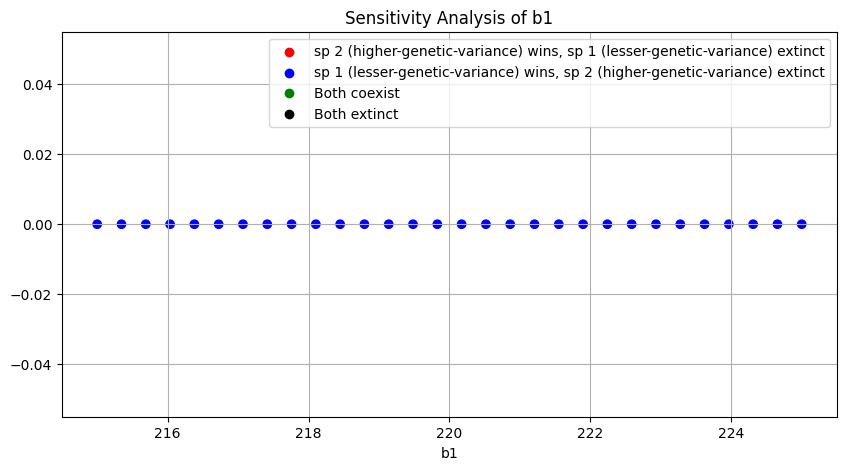

Running sensitivity analysis for b2...


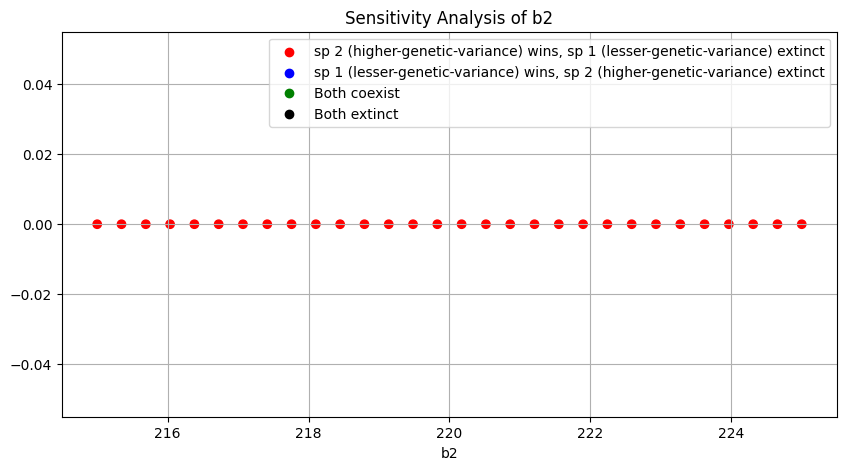

Running sensitivity analysis for alpha11...


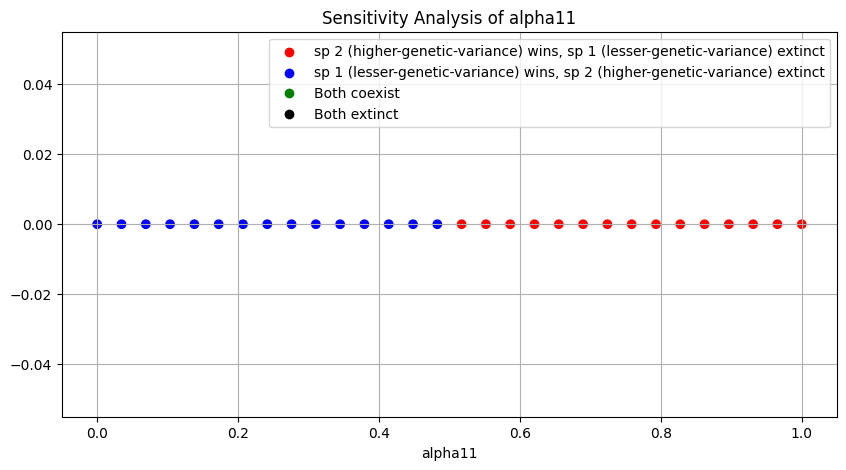

Running sensitivity analysis for alpha22...


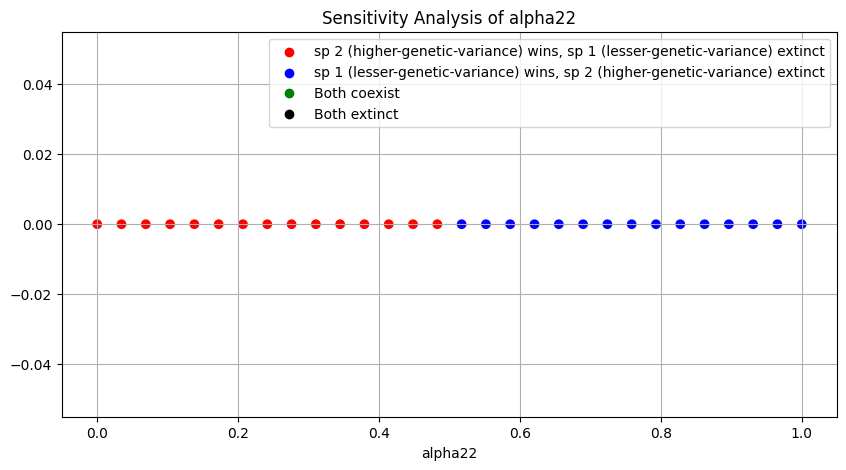

Running sensitivity analysis for alpha12...


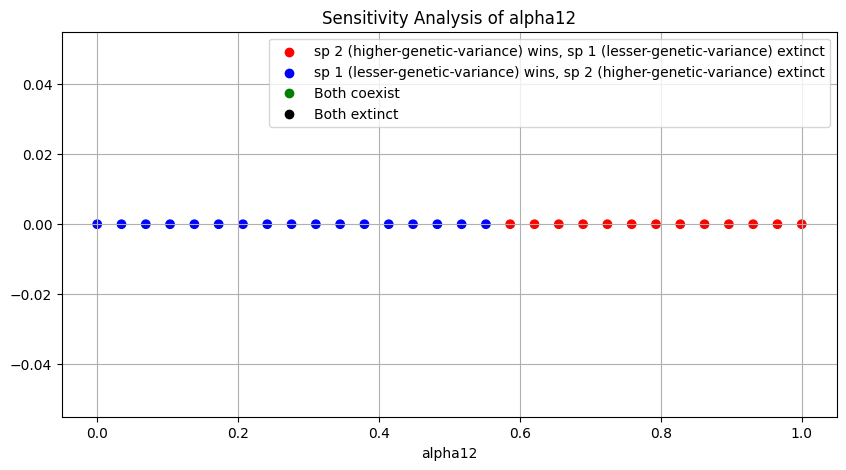

Running sensitivity analysis for alpha21...


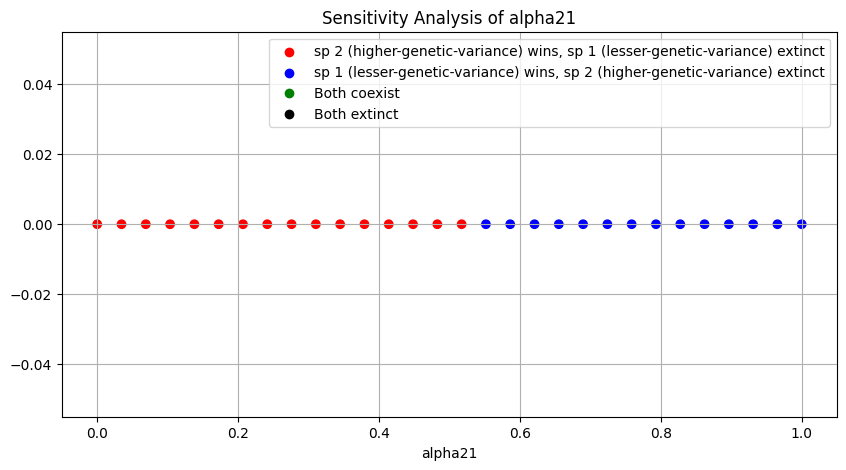

Running sensitivity analysis for z_m1_initial...


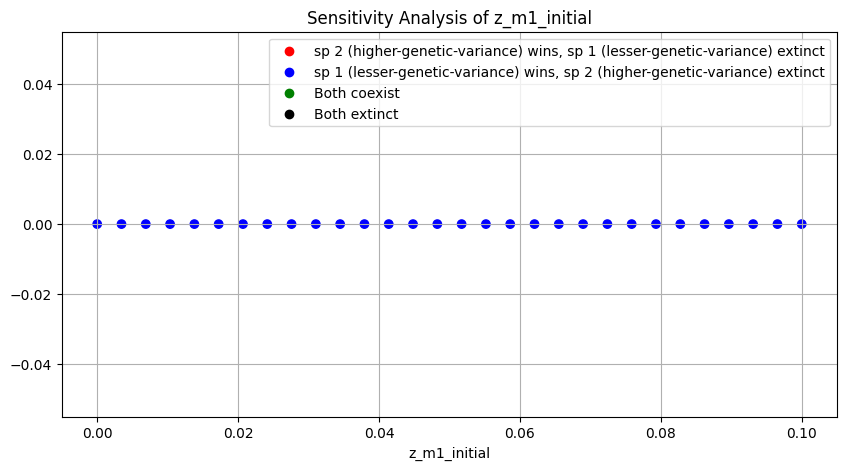

Running sensitivity analysis for z_m2_initial...


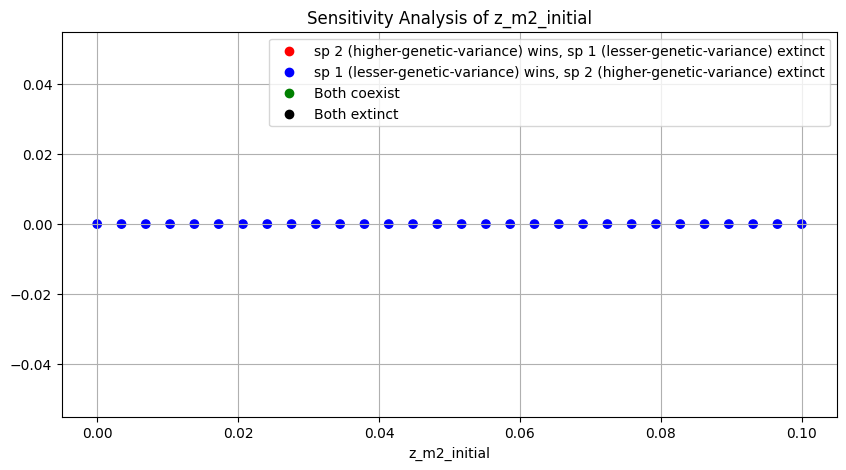

Running sensitivity analysis for cost_to_males...


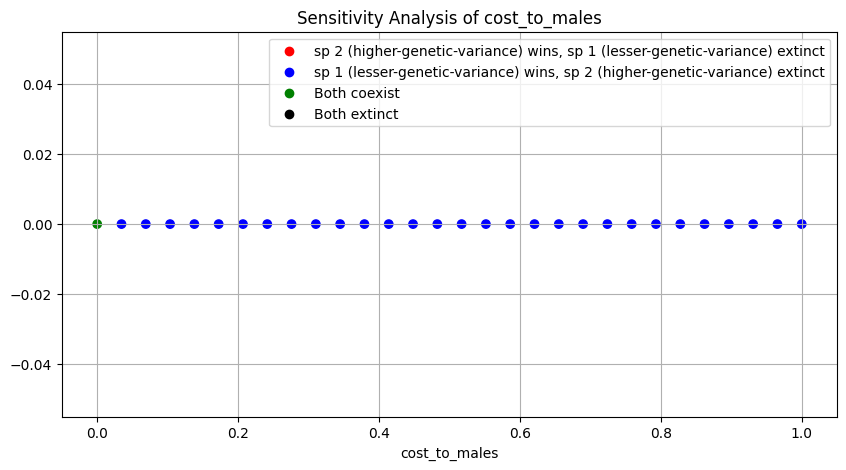

Running sensitivity analysis for strength_of_interference...


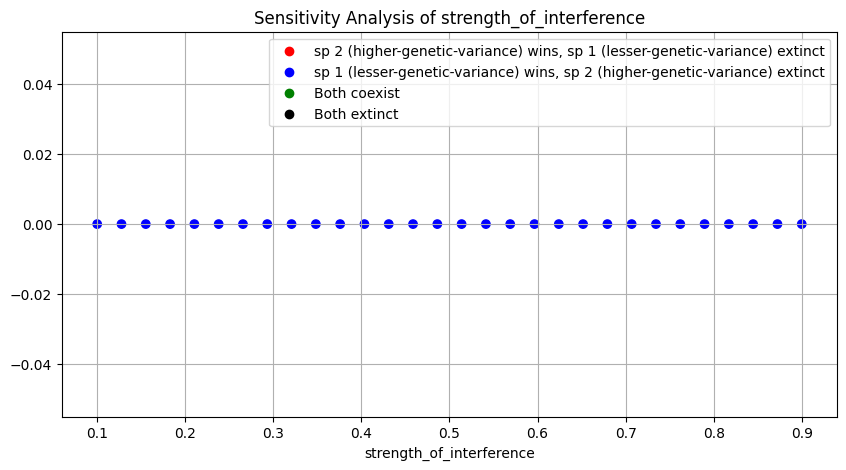

Running sensitivity analysis for V_A1...


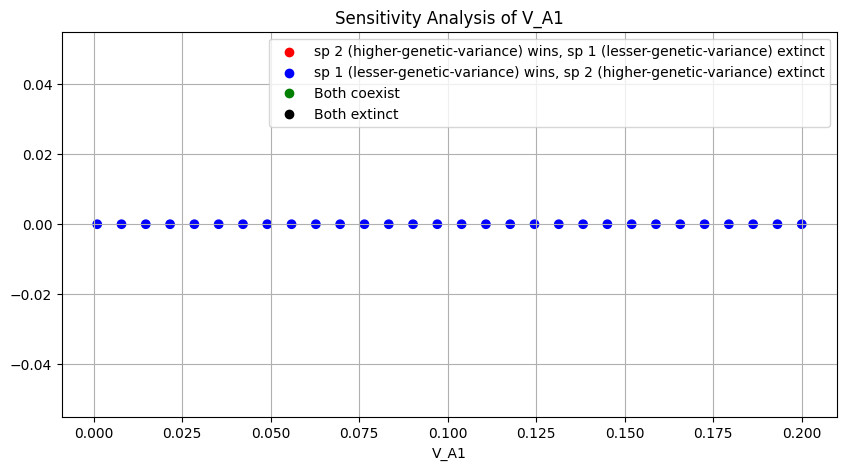

Running sensitivity analysis for V_A2...


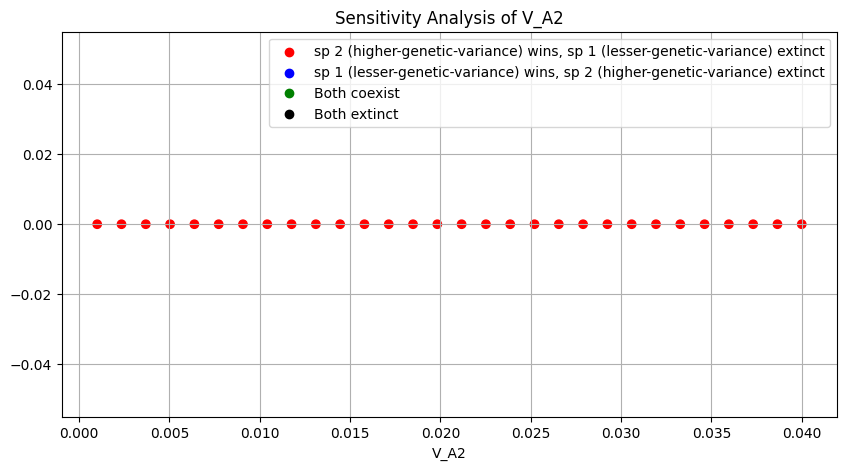

In [ ]:
def plot_sensitivity_analysis(parameter_values, final_outcomes_list, parameter_name):  
        color_map = {"sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct": 'red', "sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct": 'blue', "both extinct"
: 'black', "both coexist": 'green'}
        
        colors = [color_map[outcome] for outcome in final_outcomes_list]
        
        plt.figure(figsize=(10, 5))
        plt.scatter(parameter_values, [0]*len(parameter_values), color=colors, marker='o')
        plt.xlabel(parameter_name)
        plt.title(f'Sensitivity Analysis of {parameter_name}')
        plt.grid(True)
        # Adding legend manually
        plt.scatter([], [], color='red', label="sp 2 (higher-genetic-variance) wins, sp 1 (lesser-genetic-variance) extinct")
        plt.scatter([], [], color='blue', label= "sp 1 (lesser-genetic-variance) wins, sp 2 (higher-genetic-variance) extinct")
        plt.scatter([], [], color='green', label='Both coexist')
        plt.scatter([], [], color='black', label='Both extinct')
        plt.legend(loc='upper right')
        plt.show()

def generate_parameters_with_varied_parameter(parameter_name, base_parameters, parameter_values):  #base parameters, parameter name taken, and the different values of that parametereter are taken
    parameters_list = []
    for value in parameter_values:   
        parameters_dict = Parameters_for_Analysis(base_parameters).__dict__.copy() #create a default instance of the Parameters_for_Analysis class and then copy the dictionary of the instance
        parameters_dict[parameter_name] = value             #Thuis dictionary is then inserted into the Parameters_for_Analysis class which creates yet abother instance
        parameters = Parameters_for_Analysis(base_parameters, **parameters_dict)
        parameters_list.append(parameters)      #all the instances are appended to a list
    return parameters_list

def run_sensitivity_analysis(parameters_list):
    final_outcomes_list = []
    for parameters in parameters_list:
        final_outcome_instance = run_simulation_and_get_outcome_instance(parameters)
        final_outcomes_list.append(final_outcome_instance.outcome)
    return final_outcomes_list

def main():
    # Base parameters

    # parameters to vary
    parameter_ranges = {                  #for each parametereter name, the range of values to vary over is definedm as a dictionary
        'b1': np.linspace(215, 225, 30),
        'b2': np.linspace(215, 225, 30),
        'alpha11': np.linspace(0, 1, 30),
        'alpha22': np.linspace(0, 1, 30),
        'alpha12': np.linspace(0, 1, 30),
        'alpha21': np.linspace(0, 1, 30),
        'z_m1_initial': np.linspace(0, 0.1, 30),
        'z_m2_initial': np.linspace(0, 0.1, 30),
        'cost_to_males': np.linspace(0, 1, 30),
        'strength_of_interference': np.linspace(0.1, 0.9, 30),
        'V_A1': np.linspace(0.001, 0.2, 30),
        'V_A2': np.linspace(0.001, 0.04, 30)
    }

    parameter_names = parameter_ranges.keys()   #the keys of the parameter_ranges dictionary are extracted and stored in the parameter_names list

    for parameter_name in parameter_names:      #for each parametereter, the sensitivity analysis is run and a corresponding plot is generated
        print(f"Running sensitivity analysis for {parameter_name}...")
        parameter_values = parameter_ranges[parameter_name]     #the values of the corresponding parametereter are extracted from the parameter_ranges_dictionary        
        parameters_list = generate_parameters_with_varied_parameter(parameter_name, base_parameters, parameter_values) #parameters list is a list of instances created with the varied parametereter values
        final_outcomes_list = run_sensitivity_analysis(parameters_list) 
        plot_sensitivity_analysis(parameter_values, final_outcomes_list, parameter_name)

if __name__ == "__main__":
    main()



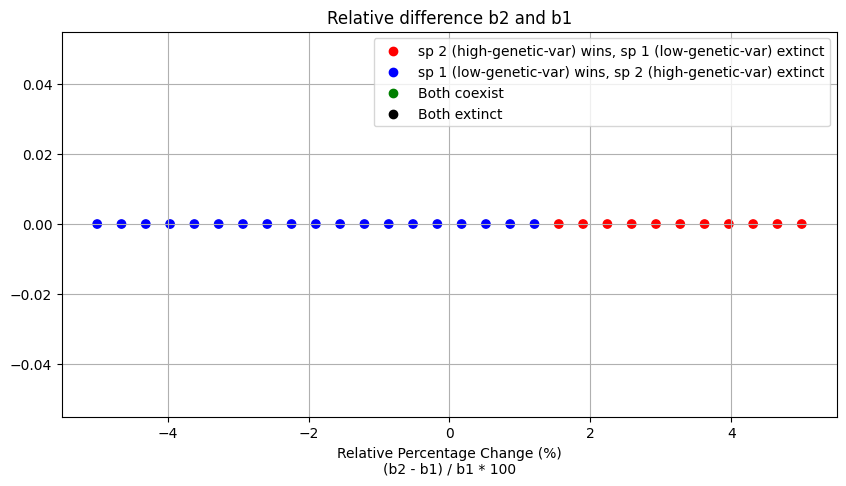

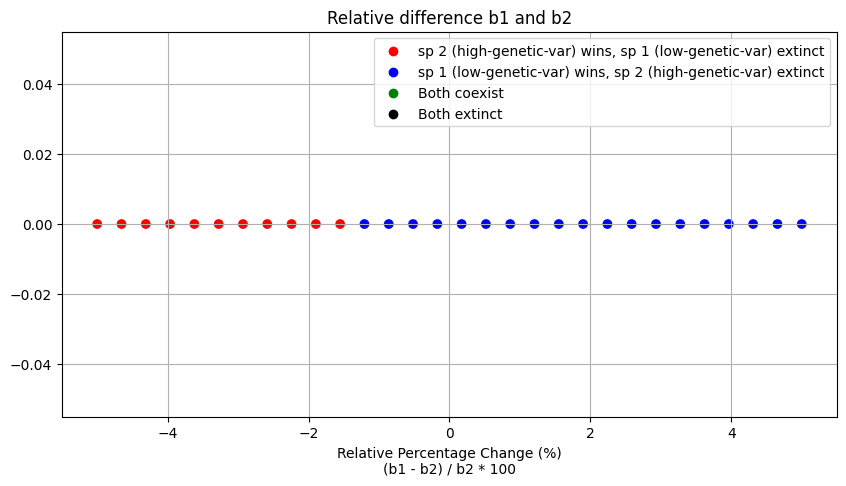

In [ ]:
def plot_sensitivity_analysis_comparison(parameter_values, final_outcomes_list, parameter_name, baseline_parameter, comparison_parameter):
    color_map = {
        "sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct": 'red',
        "sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct": 'blue',
        "both extinct": 'black',
        "both coexist": 'green'
    }
    
    colors = [color_map[outcome] for outcome in final_outcomes_list]
    
    plt.figure(figsize=(10, 5))
    plt.scatter(parameter_values, [0]*len(parameter_values), color=colors, marker='o')
    
    plt.xlabel(f'Relative Percentage Change (%)\n({comparison_parameter} - {baseline_parameter}) / {baseline_parameter} * 100')
    plt.title(f'Relative difference {parameter_name} and {baseline_parameter}')
    
    plt.grid(True)
    
    # Legend with color labels
    plt.scatter([], [], color='red', label="sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct")
    plt.scatter([], [], color='blue', label="sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct")
    plt.scatter([], [], color='green', label='Both coexist')
    plt.scatter([], [], color='black', label='Both extinct')
    plt.legend(loc='upper right')
    
    plt.show()
def main():
    # Example usage for b2 - b1 comparison
    comparison_birth_rates = [
        ('b2', 'b1'),
        ('b1', 'b2'),
    ]


    
    for comparison_parameter, baseline_parameter in comparison_birth_rates:
        baseline_value = Parameters_for_Analysis(base_parameters).__dict__[baseline_parameter]
        parameter_values = np.linspace(baseline_value - 0.05 * baseline_value, baseline_value + 0.05 * baseline_value, 30)  # Varying comparison_parameter
        
        parameters_list = generate_parameters_with_varied_parameter(comparison_parameter, base_parameters, parameter_values)
        final_outcomes_list = run_sensitivity_analysis(parameters_list)
        
        transformed_values = ((parameter_values - baseline_value) / baseline_value) * 100
        plot_sensitivity_analysis_comparison(transformed_values, final_outcomes_list, comparison_parameter, baseline_parameter, comparison_parameter)

    # for comparison_parameter, baseline_parameter in comparisons_ks:
    #     baseline_value = Parameters_for_Analysis().__dict__[baseline_parameter]
    #     parameter_values = np.linspace(baseline_value - 0.5 * baseline_value, baseline_value + 0.5 * baseline_value, 30)

    #     parameters_list = generate_parameters_with_varied_parameter(comparison_parameter, parameter_values)
    #     final_outcomes_list = run_sensitivity_analysis(parameters_list)

    #     transformed_values = ((parameter_values - baseline_value) / baseline_value) * 100
    #     plot_sensitivity_analysis_comparison(transformed_values, final_outcomes_list, comparison_parameter, baseline_parameter, comparison_parameter)


if __name__ == "__main__":
    main()


In [ ]:
'''The slow evolving species wins in the default case. What if the slow evolving species started out as a good discriminator (hence poor initial satyr effect). Fast species initially has good satyr effect, but will soon evolve to become worse'''
z_m1_initial_list = np.arange(0.5, 1, 0.1)
for z_m1_initial_value in z_m1_initial_list:
    parameters_temp = Parameters_for_Analysis(base_parameters = base_parameters, z_m1_initial=z_m1_initial_value)
    print(parameters_temp.__dict__)

    outcome_stats_and_plots_instance_temp_z = run_simulation_and_get_outcome_instance(parameters_temp)
    print(outcome_stats_and_plots_instance_temp_z.outcome)
    print("z_m1_initial =", parameters_temp.z_m1_initial)
    outcome_stats_and_plots_instance_temp_z.plot_population_dynamics_and_trait_evolution()


'''Insights: 
1. The slow evolving species wins in the default case.
2. Initial difference in satyr effect matters more than later (stength of satyr effect is depednant on relative population sizes, if population size of a sp. reduces its satyr effect reduces). 
    If V_A1 = 0.01, and V_A2 = 0.1, then the slow evolving species wins. 
3. There is coexistence - wtf (V_A1 = 0.1, V_A2 = 0.5)
4.  The traits crossing each other sometimes determines the outcome, sometimes not

'''


#sp1. being the better discriminatior should lose.


{'b1': 100, 'b2': 100, 'alpha11': 0.5, 'alpha22': 0.5, 'alpha12': 0.55, 'alpha21': 0.55, 'z_m1_initial': 0.5, 'z_m2_initial': 0, 'initial_population_species_1': 100, 'initial_population_species_2': 100, 'cost_to_males': 0.1, 'strength_of_interference': 0.05, 'V_A1': 0.5, 'V_A2': 1.5, 'num_generations': 1000}
sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct
z_m1_initial = 0.5


{'b1': 100, 'b2': 100, 'alpha11': 0.5, 'alpha22': 0.5, 'alpha12': 0.55, 'alpha21': 0.55, 'z_m1_initial': 0.6, 'z_m2_initial': 0, 'initial_population_species_1': 100, 'initial_population_species_2': 100, 'cost_to_males': 0.1, 'strength_of_interference': 0.05, 'V_A1': 0.5, 'V_A2': 1.5, 'num_generations': 1000}
sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct
z_m1_initial = 0.6


{'b1': 100, 'b2': 100, 'alpha11': 0.5, 'alpha22': 0.5, 'alpha12': 0.55, 'alpha21': 0.55, 'z_m1_initial': 0.7, 'z_m2_initial': 0, 'initial_population_species_1': 100, 'initial_population_species_2': 100, 'cost_to_males': 0.1, 'strength_of_interference': 0.05, 'V_A1': 0.5, 'V_A2': 1.5, 'num_generations': 1000}
sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct
z_m1_initial = 0.7


{'b1': 100, 'b2': 100, 'alpha11': 0.5, 'alpha22': 0.5, 'alpha12': 0.55, 'alpha21': 0.55, 'z_m1_initial': 0.7999999999999999, 'z_m2_initial': 0, 'initial_population_species_1': 100, 'initial_population_species_2': 100, 'cost_to_males': 0.1, 'strength_of_interference': 0.05, 'V_A1': 0.5, 'V_A2': 1.5, 'num_generations': 1000}
sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct
z_m1_initial = 0.7999999999999999


{'b1': 100, 'b2': 100, 'alpha11': 0.5, 'alpha22': 0.5, 'alpha12': 0.55, 'alpha21': 0.55, 'z_m1_initial': 0.8999999999999999, 'z_m2_initial': 0, 'initial_population_species_1': 100, 'initial_population_species_2': 100, 'cost_to_males': 0.1, 'strength_of_interference': 0.05, 'V_A1': 0.5, 'V_A2': 1.5, 'num_generations': 1000}
sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct
z_m1_initial = 0.8999999999999999


'Insights: \n1. The slow evolving species wins in the default case.\n2. Initial difference in satyr effect matters more than later (stength of satyr effect is depednant on relative population sizes, if population size of a sp. reduces its satyr effect reduces). \n    If V_A1 = 0.01, and V_A2 = 0.1, then the slow evolving species wins. \n3. There is coexistence - wtf (V_A1 = 0.1, V_A2 = 0.5)\n4.  The traits crossing each other sometimes determines the outcome, sometimes not\n\n'

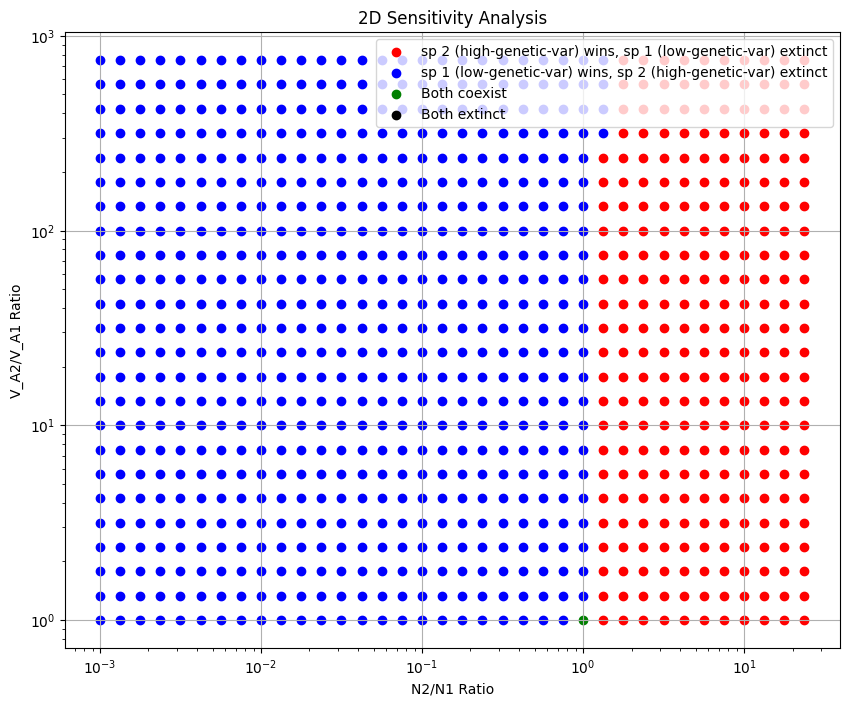

'\nFast \n\n\n'

In [ ]:
import numpy as np

def plot_2d_sensitivity_analysis(N2_N1_ratios, V_A2_V_A1_ratios, final_outcomes_matrix):
    color_map = {"sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct": 'red', "sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct": 'blue', 
                 "both extinct": 'black', "both coexist": 'green'}
    
    colors = np.vectorize(color_map.get)(final_outcomes_matrix)

    plt.figure(figsize=(10, 8))
    for i in range(len(N2_N1_ratios)):
        for j in range(len(V_A2_V_A1_ratios)):
            plt.scatter(N2_N1_ratios[i], V_A2_V_A1_ratios[j], color=colors[i, j], marker='o')

    plt.xscale('log')  # Set x-axis to log scale
    plt.yscale('log')  # Set y-axis to log scale
    plt.xlabel('N2/N1 Ratio')
    plt.ylabel('V_A2/V_A1 Ratio')
    plt.title('2D Sensitivity Analysis')
    plt.grid(True)
    
    # Adding legend manually
    plt.scatter([], [], color='red', label="sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct")
    plt.scatter([], [], color='blue', label="sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct")
    plt.scatter([], [], color='green', label='Both coexist')
    plt.scatter([], [], color='black', label='Both extinct')
    plt.legend(loc='upper right')
    plt.show()

def generate_parameters_with_varied_parameters(N2_N1_ratios, V_A2_V_A1_ratios):
    parameters_list = []
    for N2_N1 in N2_N1_ratios:
        for V_A2_V_A1 in V_A2_V_A1_ratios:
            parameters_dict = Parameters_for_Analysis(base_parameters = base_parameters, V_A1 = 0.01, V_A2 = 0.01).__dict__.copy()
            parameters_dict['initial_population_species_2'] = parameters_dict['initial_population_species_1'] * N2_N1
            parameters_dict['V_A2'] = parameters_dict['V_A1'] * V_A2_V_A1
            parameters = Parameters_for_Analysis(base_parameters = base_parameters, **parameters_dict)
            parameters_list.append(parameters)
    return parameters_list

def run_sensitivity_analysis(parameters_list):
    final_outcomes_list = []
    for parameters in parameters_list:
        final_outcome_instance = run_simulation_and_get_outcome_instance(parameters)
        final_outcomes_list.append(final_outcome_instance.outcome)
    return final_outcomes_list

def main():
    N2_N1_powers = np.arange(-3,1.5,0.125)
    V_A2_V_A1_powers = np.arange(0,3,0.125)
    
    N2_N1_ratios = np.power(10.0, N2_N1_powers)
    V_A2_V_A1_ratios = np.power(10.0, V_A2_V_A1_powers)
    
    parameters_list = generate_parameters_with_varied_parameters(N2_N1_ratios, V_A2_V_A1_ratios)
    final_outcomes_list = run_sensitivity_analysis(parameters_list)
    
    final_outcomes_matrix = np.array(final_outcomes_list).reshape(len(N2_N1_ratios), len(V_A2_V_A1_ratios))
    
    plot_2d_sensitivity_analysis(N2_N1_ratios, V_A2_V_A1_ratios, final_outcomes_matrix)

if __name__ == "__main__":
    main()

'''
Fast 


'''





In [ ]:
'''2D sensitivity analysis -  N2/N1 ratio and V_A2/V_A1 ratio'''
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

def plot_2d_sensitivity_analysis(N2_N1_ratios, V_A2_V_A1_ratios, final_outcomes_matrix):
    color_map = {"sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct": 'red', "sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct": 'blue', 
                 "both extinct": 'black', "both coexist": 'green'}
    
    colors = np.vectorize(color_map.get)(final_outcomes_matrix)

    traces = []
    for i in range(len(N2_N1_ratios)):
        for j in range(len(V_A2_V_A1_ratios)):
            traces.append(go.Scatter(
                x=[N2_N1_ratios[i]], y=[V_A2_V_A1_ratios[j]], mode='markers',
                marker=dict(color=colors[i, j]),
                showlegend=False
            ))

    fig = go.Figure(data=traces)

    fig.update_layout(
        title='2D Sensitivity Analysis',
        xaxis=dict(title='N2/N1 Ratio', type='log', tickvals=N2_N1_ratios),
        yaxis=dict(title='V_A2/V_A1 Ratio', type='log', tickvals=V_A2_V_A1_ratios),
        template='plotly',  # Set the grey theme
        width=1000,
        height=800,
    )

    # Adding legend manually
    legend_labels = [
        ("sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct", 'red'),
        ("sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct", 'blue'),
        ('Both coexist', 'green'),
        ('Both extinct', 'black')
    ]

    for label, color in legend_labels:
        fig.add_trace(go.Scatter(
            x=[None], y=[None], mode='markers',
            marker=dict(color=color),
            showlegend=True,
            name=label
        ))

    pio.show(fig)  # Use pio.show to display the plot

def generate_parameters_with_varied_parameters(N2_N1_ratios, V_A2_V_A1_ratios):
    parameters_list = []
    for N2_N1 in N2_N1_ratios:
        for V_A2_V_A1 in V_A2_V_A1_ratios:
            parameters_dict = Parameters_for_Analysis(base_parameters = base_parameters, V_A1=1, V_A2=1).__dict__.copy()
            parameters_dict['initial_population_species_2'] = parameters_dict['initial_population_species_1'] * N2_N1
            parameters_dict['V_A2'] = parameters_dict['V_A1'] * V_A2_V_A1
            parameters = Parameters_for_Analysis(base_parameters = base_parameters, **parameters_dict)
            parameters_list.append(parameters)
    return parameters_list

def run_sensitivity_analysis(parameters_list):
    final_outcomes_list = []
    for parameters in parameters_list:
        final_outcome_instance = run_simulation_and_get_outcome_instance(parameters)
        final_outcomes_list.append(final_outcome_instance.outcome)
    return final_outcomes_list

def main():
    N2_N1_powers = np.arange(-3, 3, 0.125)
    V_A2_V_A1_powers = np.arange(0, 3, 0.125)
    
    N2_N1_ratios = np.power(10.0, N2_N1_powers)
    V_A2_V_A1_ratios = np.power(10.0, V_A2_V_A1_powers)
    
    parameters_list = generate_parameters_with_varied_parameters(N2_N1_ratios, V_A2_V_A1_ratios)
    final_outcomes_list = run_sensitivity_analysis(parameters_list)
    
    final_outcomes_matrix = np.array(final_outcomes_list).reshape(len(N2_N1_ratios), len(V_A2_V_A1_ratios))
    
    plot_2d_sensitivity_analysis(N2_N1_ratios, V_A2_V_A1_ratios, final_outcomes_matrix)

if __name__ == "__main__":
    main()


In [ ]:
'''2D sensitivity analysis - z_m1_initial - z_m2_initial,  and V_A2/V_A1 ratio'''
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

def plot_2d_sensitivity_analysis(z_m1_initial_z_m2_initial_difference_list, V_A2_V_A1_ratios, final_outcomes_matrix):
    color_map = {"sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct": 'red', "sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct": 'blue', 
                 "both extinct": 'black', "both coexist": 'green'}
    
    colors = np.vectorize(color_map.get)(final_outcomes_matrix)

    traces = []
    for i in range(len(z_m1_initial_z_m2_initial_difference_list)):
        for j in range(len(V_A2_V_A1_ratios)):
            traces.append(go.Scatter(
                x=[z_m1_initial_z_m2_initial_difference_list[i]], y=[V_A2_V_A1_ratios[j]], mode='markers',
                marker=dict(color=colors[i, j]),
                showlegend=False
            ))

    fig = go.Figure(data=traces)

    fig.update_layout(
        title='2D Sensitivity Analysis',
        xaxis=dict(title= "initial discrimination difference (sp. 1 - sp2)", tickvals=z_m1_initial_z_m2_initial_difference_list),
        yaxis=dict(title='V_A2/V_A1 Ratio', type='log', tickvals=V_A2_V_A1_ratios),
        template='plotly',  # Set the grey theme
        width=1000,
        height=800,
    )

    # Adding legend manually
    legend_labels = [
        ("sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct", 'red'),
        ("sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct", 'blue'),
        ('Both coexist', 'green'),
        ('Both extinct', 'black')
    ]

    for label, color in legend_labels:
        fig.add_trace(go.Scatter(
            x=[None], y=[None], mode='markers',
            marker=dict(color=color),
            showlegend=True,
            name=label
        ))

    pio.show(fig)  # Use pio.show to display the plot

def generate_parameters_with_varied_parameters(z_m1_initial_z_m2_initial_difference_list, V_A2_V_A1_ratios):
    parameters_list = []
    for z_m1_initial_z_m2_initial_difference in z_m1_initial_z_m2_initial_difference_list:
        for V_A2_V_A1 in V_A2_V_A1_ratios:
            parameters_dict = Parameters_for_Analysis(base_parameters = base_parameters, V_A1=0.01, V_A2=0.01).__dict__.copy()
            parameters_dict['z_m1_initial'] = parameters_dict['z_m2_initial'] + z_m1_initial_z_m2_initial_difference
            parameters_dict['V_A2'] = parameters_dict['V_A1'] * V_A2_V_A1
            parameters = Parameters_for_Analysis(base_parameters = base_parameters, **parameters_dict)
            parameters_list.append(parameters)
    return parameters_list

def run_sensitivity_analysis(parameters_list):
    final_outcomes_list = []
    for parameters in parameters_list:
        final_outcome_instance = run_simulation_and_get_outcome_instance(parameters)
        final_outcomes_list.append(final_outcome_instance.outcome)
    return final_outcomes_list

def main():
    z_m1_initial_z_m2_initial_difference_list = np.arange(0, 1, 0.1)
    V_A2_V_A1_powers = np.arange(0, 3, 1)
    
    V_A2_V_A1_ratios = np.power(10.0, V_A2_V_A1_powers)
    
    parameters_list = generate_parameters_with_varied_parameters(z_m1_initial_z_m2_initial_difference_list, V_A2_V_A1_ratios)
    final_outcomes_list = run_sensitivity_analysis(parameters_list)
    
    final_outcomes_matrix = np.array(final_outcomes_list).reshape(len(z_m1_initial_z_m2_initial_difference_list), len(V_A2_V_A1_ratios))
    
    plot_2d_sensitivity_analysis(z_m1_initial_z_m2_initial_difference_list, V_A2_V_A1_ratios, final_outcomes_matrix)

if __name__ == "__main__":
    main()


In [ ]:
'''robustness of the outcome to perturbations in the parameters'''

'robustness of the outcome to perturbations in the parameters'

In [ ]:


# Define parameter ranges with limited values
b_values = np.linspace(50, 200, 7)
strength_of_interference_values = np.linspace(0, 1, 7)
cost_to_males_values = np.linspace(0.1, 0.99, 7)
intraspecific_competition_values = np.linspace(0.5, 2, 7)
interspecific_competition_values = np.linspace(0.5, 2, 7)
genetic_variablity_multiplier = np.linspace(1, 5, 7)
V_A1_values = np.linspace(0.01, 0.5, 7)

# Create all parameter combinations
parameter_combinations = itertools.product(
    b_values, 
    strength_of_interference_values, 
    cost_to_males_values, 
    intraspecific_competition_values, 
    interspecific_competition_values, 
    genetic_variablity_multiplier, 
    V_A1_values
)

# Create an Excel writer object
writer = pd.ExcelWriter('parameter_combinations_test.xlsx', engine='xlsxwriter')

# Write combinations to separate sheets in the Excel file
chunk_size = 10000
data = []
sheet_count = 1

for idx, combo in enumerate(parameter_combinations):
    b, strength_of_interference, cost_to_males, intraspecific_competition, interspecific_competition, genetic_multiplier, V_A1 = combo
    V_A2 = V_A1 * genetic_multiplier  # Calculate V_A2
    alpha11 = alpha22 = intraspecific_competition
    alpha12 = alpha21 = interspecific_competition
    data.append((b, strength_of_interference, cost_to_males, intraspecific_competition, interspecific_competition, genetic_multiplier, V_A1, V_A2, alpha11, alpha22, alpha12, alpha21))
    
    if (idx + 1) % chunk_size == 0:
        df_chunk = pd.DataFrame(data, columns=[
            'b', 'strength_of_interference', 'cost_to_males', 'intraspecific_competition', 
            'interspecific_competition', 'genetic_variablity_multiplier', 'V_A1', 'V_A2', 
            'alpha11', 'alpha22', 'alpha12', 'alpha21'
        ])
        df_chunk.to_excel(writer, sheet_name=f'Sheet{sheet_count}', index=False)
        sheet_count += 1
        data = []

# Write any remaining data
if data:
    df_chunk = pd.DataFrame(data, columns=[
        'b', 'strength_of_interference', 'cost_to_males', 'intraspecific_competition', 
        'interspecific_competition', 'genetic_variablity_multiplier', 'V_A1', 'V_A2', 
        'alpha11', 'alpha22', 'alpha12', 'alpha21'
    ])
    df_chunk.to_excel(writer, sheet_name=f'Sheet{sheet_count}', index=False)

# Save the Excel file
writer.close()

In [ ]:

def get_outcome(row):
    try:
        # Define parameters for the analysis
        parameters_temp = Parameters_for_Analysis(
            base_parameters=base_parameters,
            b1=row['b'],
            b2=row['b'],
            alpha11=row['alpha11'],
            alpha22=row['alpha22'],
            alpha12=row['alpha12'],
            alpha21=row['alpha21'],
            strength_of_interference=row['strength_of_interference'],
            cost_to_males=row['cost_to_males'],
            initial_population_species_1=initial_population_from_carrying_capacity(
                row['b'], alpha11, alpha12,
                row['b'], alpha22, alpha21
            ),
            initial_population_species_2=initial_population_from_carrying_capacity(
                row['b'], alpha11, alpha12,
                row['b'], alpha22, alpha21
            ),
            V_A1=row['V_A1'],
            V_A2=row['V_A2']
        )

        
        # Run simulation and get outcome
        outcome_stats_and_plots_instance_temp_z = run_simulation_and_get_outcome_instance(parameters_temp)
        return outcome_stats_and_plots_instance_temp_z.outcome
    
    except Exception as e:
        print("An error occurred with parameters:")
        print(row.to_dict())
        print(f"Error: {e}")
        return None

# Load the Excel file
xlsx = pd.ExcelFile('parameter_combinations_test.xlsx')

# Create a writer object to save the updated Excel file
with pd.ExcelWriter('updated_parameter_combinations.xlsx') as writer:
    # Process each sheet
    for sheet_name in xlsx.sheet_names:
        # Load sheet data
        chunk = pd.read_excel(xlsx, sheet_name=sheet_name)
        
        # Apply get_outcome to each row and store the results in a new column
        chunk['outcome'] = chunk.apply(get_outcome, axis=1)
        
        # Write the updated chunk to the new Excel file
        chunk.to_excel(writer, sheet_name=sheet_name, index=False)

# Display the results (for the newly created Excel file)
updated_xlsx = pd.ExcelFile('updated_parameter_combinations.xlsx')
print(f"Total winning combinations processed: {len(updated_xlsx.sheet_names)}")
for sheet_name in updated_xlsx.sheet_names:
    df = pd.read_excel(updated_xlsx, sheet_name=sheet_name)
    # print(f"Sheet: {sheet_name}")
    # print(df.head())


An error occurred with parameters:
{'b': 50.0, 'strength_of_interference': 0.0, 'cost_to_males': 0.01, 'intraspecific_competition': 0.5, 'interspecific_competition': 0.5, 'genetic_variablity_multiplier': 1.0, 'V_A1': 0.01, 'V_A2': 0.01, 'alpha11': 0.5, 'alpha22': 0.5, 'alpha12': 0.5, 'alpha21': 0.5}
Error: name 'Parameters_for_Analysis' is not defined
An error occurred with parameters:
{'b': 50.0, 'strength_of_interference': 0.0, 'cost_to_males': 0.01, 'intraspecific_competition': 0.5, 'interspecific_competition': 0.5, 'genetic_variablity_multiplier': 1.0, 'V_A1': 0.09166666666666666, 'V_A2': 0.09166666666666666, 'alpha11': 0.5, 'alpha22': 0.5, 'alpha12': 0.5, 'alpha21': 0.5}
Error: name 'Parameters_for_Analysis' is not defined
An error occurred with parameters:
{'b': 50.0, 'strength_of_interference': 0.0, 'cost_to_males': 0.01, 'intraspecific_competition': 0.5, 'interspecific_competition': 0.5, 'genetic_variablity_multiplier': 1.0, 'V_A1': 0.1733333333333333, 'V_A2': 0.173333333333333

KeyboardInterrupt: 

In [ ]:
def perturbation_test(row):
    
    # Create a copy of the parameters from the row
    perturbed_parameters = Parameters_for_Analysis(
        base_parameters=base_parameters,
        b1=row['b'],
        b2=row['b'],
        alpha11=row['alpha11'],
        alpha22=row['alpha22'],
        alpha12=row['alpha12'],
        alpha21=row['alpha21'],
        strength_of_interference=row['strength_of_interference'],
        cost_to_males=row['cost_to_males'],
        initial_population_species_1=initial_population_from_carrying_capacity(
            row['b'], row['alpha11'], row['alpha12'],
            row['b'], row['alpha22'], row['alpha21']
        ),
        initial_population_species_2=initial_population_from_carrying_capacity(
            row['b'], row['alpha11'], row['alpha12'],
            row['b'], row['alpha22'], row['alpha21']
        ),
        V_A1=row['V_A1'],
        V_A2=row['V_A2']
    )
    
    # Apply perturbations
    perturbed_parameters.alpha12 *= 1.1
    perturbed_parameters.z_m1_initial += 0.3
    perturbed_parameters.b2 *= 1.1
    perturbed_parameters.initial_population_species_2 *= 1.3
    
    # Run simulation with perturbed parameters
    outcome_instance = run_simulation_and_get_outcome_instance(perturbed_parameters)
    
    # Expected outcome
    expected_outcome = 'sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct'
    
    # Check if the outcome is as expected
    if outcome_instance.outcome == expected_outcome:
        return "passed"
    else:
        return "failed"

def apply_perturbation_test(row):
    if row['outcome'] == 'sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct':
        return perturbation_test(row)
    return None

# Load the updated Excel file
updated_xlsx = pd.ExcelFile('updated_parameter_combinations.xlsx')

total_passed = 0  # Initialize counter for passed perturbation tests
total_failed = 0  # Initialize counter for failed perturbation tests

# Create a writer object to save the perturbation test results
with pd.ExcelWriter('perturbation_test_results.xlsx') as writer:
    for sheet_name in updated_xlsx.sheet_names:
        df = pd.read_excel(updated_xlsx, sheet_name=sheet_name)
        
        # Apply perturbation test to rows where outcome matches the condition
        df['perturbation_test'] = df.apply(apply_perturbation_test, axis=1)
        
        # Count the number of passed and failed perturbation tests
        test_counts = df['perturbation_test'].value_counts()
        passed_count = test_counts.get('passed', 0)
        failed_count = test_counts.get('failed', 0)
        
        total_passed += passed_count
        total_failed += failed_count
        
        # Write the updated data with perturbation test results
        df.to_excel(writer, sheet_name=sheet_name, index=False)
        
        # Print the count of passed and failed perturbation tests for each sheet

# Print the total number of passed and failed perturbation tests across all sheets
print(f"Total number of passed perturbation tests: {total_passed}")
print(f"Total number of failed perturbation tests: {total_failed}")


Total number of passed perturbation tests: 0
Total number of failed perturbation tests: 502435


In [ ]:
# Load the perturbation test results Excel file
perturbation_test_results = pd.ExcelFile('perturbation_test_results.xlsx')

# Initialize dictionaries to store data for each outcome category
outcome_data = {
    "both extinct": [],
    "both coexist": [],
    "sp 2 (high-genetic-var) wins, sp 1 (low-genetic-var) extinct": [],
    "sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct": []
}

# Process each sheet to collect data
for sheet_name in perturbation_test_results.sheet_names:
    df = pd.read_excel(perturbation_test_results, sheet_name=sheet_name)
    for outcome in outcome_data.keys():
        outcome_df = df[df['outcome'] == outcome].drop(columns=['perturbation_test', 'outcome'], errors='ignore')
        if not outcome_df.empty:
            outcome_data[outcome].append(outcome_df)

# Compute means for each outcome category
means_summary = {outcome: pd.concat(data_frames).mean().to_frame().T for outcome, data_frames in outcome_data.items() if data_frames}

# Identify parameters with specific outcome and check perturbation test
specific_outcome_df = df[df['outcome'] == "sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct"]
means_passed_df = specific_outcome_df[specific_outcome_df['perturbation_test'] == 'passed'].drop(columns=['perturbation_test', 'outcome']).mean().to_frame().T.assign(Status='passed')
means_failed_df = specific_outcome_df[specific_outcome_df['perturbation_test'] == 'failed'].drop(columns=['perturbation_test', 'outcome']).mean().to_frame().T.assign(Status='failed')

# Combine passed and failed means
means_test_summary = pd.concat([means_passed_df, means_failed_df], ignore_index=True, keys=['passed', 'failed']).rename(columns={'Status': 'Outcome'})

# Convert means summary to DataFrame for visualization
means_summary_df = pd.concat(means_summary.values(), keys=means_summary.keys()).reset_index(level=0).rename(columns={'level_0': 'Outcome'})
merged_means = pd.concat([means_summary_df, means_test_summary]).melt(id_vars=['Outcome'], var_name='Parameter', value_name='Mean Value')

# Create the bar plot using Plotly
fig = go.Figure()
for outcome in merged_means['Outcome'].unique():
    subset = merged_means[merged_means['Outcome'] == outcome]
    fig.add_trace(go.Bar(
        x=subset['Parameter'],
        y=subset['Mean Value'],
        name=outcome,
        text=[f'{val:.2f}' for val in subset['Mean Value']],
        textposition='auto'
    ))

# Update layout
fig.update_layout(
    title='Mean Values of Parameters by Outcome and Perturbation Test Results',
    xaxis_title='Parameter',
    yaxis_title='Mean Value',
    barmode='group'
)

fig.show()

In [1]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import graphviz

# Load the perturbation test results Excel file
perturbation_test_results = pd.ExcelFile('perturbation_test_results.xlsx')

# Concatenate all sheets into a single DataFrame
all_sheets_df = pd.concat([pd.read_excel(perturbation_test_results, sheet_name=sheet) for sheet in perturbation_test_results.sheet_names])

# Drop unnecessary columns and handle missing values
data = all_sheets_df.drop(columns=['perturbation_test', 'outcome'], errors='ignore')
data = data.fillna(0)  # Replace NaNs with 0 or use a more appropriate strategy if needed

# Encode categorical outcomes
outcome_encoder = LabelEncoder()
data['outcome'] = outcome_encoder.fit_transform(all_sheets_df['outcome'])

# Prepare features and target
X = data.drop(columns=['outcome'])
y = data['outcome']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train the decision tree classifier
clf = DecisionTreeClassifier(random_state=42)
clf.fit(X_train, y_train)

# Visualize the decision tree
dot_data = export_graphviz(clf, out_file=None, 
                           feature_names=X.columns,
                           class_names=outcome_encoder.classes_,
                           filled=True, rounded=True,  
                           special_characters=True)  
graph = graphviz.Source(dot_data)  
graph.render('decision_tree', format='png')  # Save the visualization
graph.view()  # Open the visualization

print("Decision Tree model trained and visualized.")


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.479997 to fit


Decision Tree model trained and visualized.


Logistic Regression Model Accuracy: 0.81


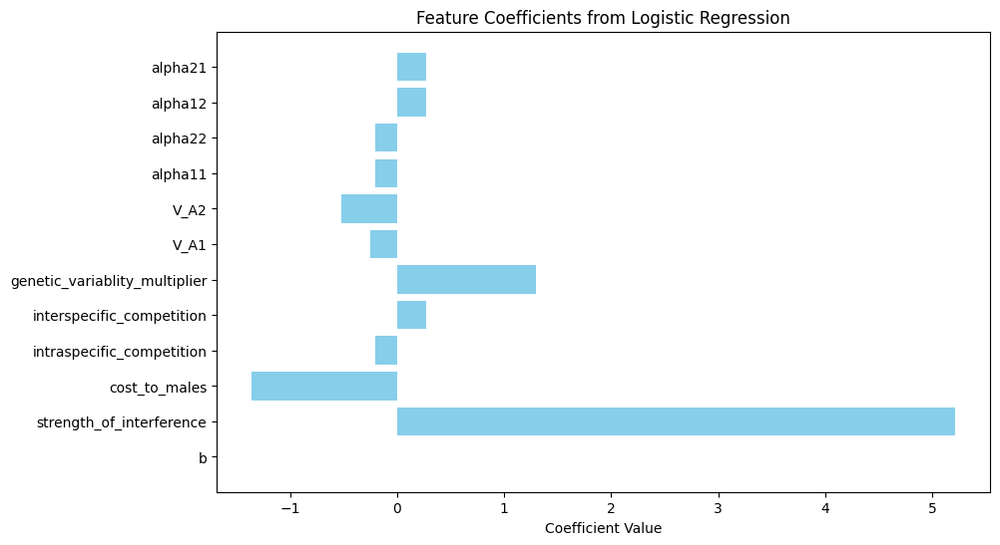

In [5]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, accuracy_score

# Load the perturbation test results Excel file
perturbation_test_results = pd.ExcelFile('perturbation_test_results.xlsx')

# Concatenate all sheets into a single DataFrame
all_sheets_df = pd.concat([pd.read_excel(perturbation_test_results, sheet_name=sheet) for sheet in perturbation_test_results.sheet_names])

# Drop non-numeric columns and handle missing values
data = all_sheets_df.drop(columns=['perturbation_test'], errors='ignore')
data = data.fillna(0)  # Replace NaNs with 0 or use a more appropriate strategy if needed

# Filter and encode the target variable for the specified outcomes
data = data[data['outcome'].isin(['both coexist', 'sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct'])]
target_encoder = LabelEncoder()
data['outcome_encoded'] = target_encoder.fit_transform(data['outcome'])

# Prepare features and target
X = data.drop(columns=['outcome', 'outcome_encoded'])
y = data['outcome_encoded']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train the logistic regression model
log_reg = LogisticRegression(max_iter=1000, random_state=42)
log_reg.fit(X_train, y_train)

# Predict on the test set
y_pred = log_reg.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
# report = classification_report(y_test, y_pred, target_names=target_encoder.classes_)

print(f"Logistic Regression Model Accuracy: {accuracy:.2f}")
# print("Classification Report:")
# print(report)

# Optional: Coefficients visualization
import matplotlib.pyplot as plt

# Plot feature coefficients
coefficients = log_reg.coef_[0]
features = X.columns
plt.figure(figsize=(10, 6))
plt.barh(features, coefficients, color='skyblue')
plt.xlabel('Coefficient Value')
plt.title('Feature Coefficients from Logistic Regression')
plt.show()

In [6]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, accuracy_score
import matplotlib.pyplot as plt

# Load the perturbation test results Excel file
perturbation_test_results = pd.ExcelFile('perturbation_test_results.xlsx')

# Concatenate all sheets into a single DataFrame
all_sheets_df = pd.concat([pd.read_excel(perturbation_test_results, sheet_name=sheet) for sheet in perturbation_test_results.sheet_names])

# Fill missing values
all_sheets_df = all_sheets_df.fillna(0)

# Ensure the 'outcome' and 'perturbation_test' columns are present
if 'outcome' not in all_sheets_df.columns or 'perturbation_test' not in all_sheets_df.columns:
    raise KeyError("The required columns 'outcome' and 'perturbation_test' are not present in the DataFrame.")

# Encode the target variables for outcomes
outcome_encoder = LabelEncoder()
all_sheets_df['outcome_encoded'] = outcome_encoder.fit_transform(all_sheets_df['outcome'])

# Prepare features and target for the outcome prediction
X_outcome = all_sheets_df.drop(columns=['outcome', 'outcome_encoded', 'perturbation_test'])
y_outcome = all_sheets_df['outcome_encoded']

# Split the data into training and testing sets
X_train_outcome, X_test_outcome, y_train_outcome, y_test_outcome = train_test_split(X_outcome, y_outcome, test_size=0.3, random_state=42)

# Train the logistic regression model for outcomes
log_reg_outcome = LogisticRegression(max_iter=1000, random_state=42)
log_reg_outcome.fit(X_train_outcome, y_train_outcome)

# Predict on the test set for outcomes
y_pred_outcome = log_reg_outcome.predict(X_test_outcome)

# Evaluate the model for outcomes
accuracy_outcome = accuracy_score(y_test_outcome, y_pred_outcome)
report_outcome = classification_report(y_test_outcome, y_pred_outcome, target_names=outcome_encoder.classes_)

print(f"Logistic Regression Model Accuracy (Outcome): {accuracy_outcome:.2f}")
print("Classification Report (Outcome):")
print(report_outcome)

# Encode perturbation test results as target
perturbation_encoder = LabelEncoder()
all_sheets_df['perturbation_test_encoded'] = perturbation_encoder.fit_transform(all_sheets_df['perturbation_test'])

# Prepare features and target for perturbation test prediction
X_perturbation = all_sheets_df.drop(columns=['outcome', 'outcome_encoded', 'perturbation_test', 'perturbation_test_encoded'])
y_perturbation = all_sheets_df['perturbation_test_encoded']

# Split the data into training and testing sets
X_train_perturbation, X_test_perturbation, y_train_perturbation, y_test_perturbation = train_test_split(X_perturbation, y_perturbation, test_size=0.3, random_state=42)

# Train the logistic regression model for perturbation tests
log_reg_perturbation = LogisticRegression(max_iter=1000, random_state=42)
log_reg_perturbation.fit(X_train_perturbation, y_train_perturbation)

# Predict on the test set for perturbation tests
y_pred_perturbation = log_reg_perturbation.predict(X_test_perturbation)

# Evaluate the model for perturbation tests
accuracy_perturbation = accuracy_score(y_test_perturbation, y_pred_perturbation)
report_perturbation = classification_report(y_test_perturbation, y_pred_perturbation, target_names=perturbation_encoder.classes_)

print(f"Logistic Regression Model Accuracy (Perturbation Test): {accuracy_perturbation:.2f}")
print("Classification Report (Perturbation Test):")
print(report_perturbation)

# Optional: Coefficients visualization for outcome prediction
coefficients_outcome = log_reg_outcome.coef_[0]
features_outcome = X_outcome.columns
plt.figure(figsize=(10, 6))
plt.barh(features_outcome, coefficients_outcome, color='skyblue')
plt.xlabel('Coefficient Value')
plt.title('Feature Coefficients from Logistic Regression (Outcome)')
plt.show()

# Optional: Coefficients visualization for perturbation test prediction
coefficients_perturbation = log_reg_perturbation.coef_[0]
features_perturbation = X_perturbation.columns
plt.figure(figsize=(10, 6))
plt.barh(features_perturbation, coefficients_perturbation, color='salmon')
plt.xlabel('Coefficient Value')
plt.title('Feature Coefficients from Logistic Regression (Perturbation Test)')
plt.show()


Logistic Regression Model Accuracy (Outcome): 0.81
Classification Report (Outcome):
                                                              precision    recall  f1-score   support

                                                both coexist       0.79      0.76      0.77      9915
sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct       0.83      0.85      0.84     13523

                                                    accuracy                           0.81     23438
                                                   macro avg       0.81      0.80      0.80     23438
                                                weighted avg       0.81      0.81      0.81     23438



TypeError: Encoders require their input argument must be uniformly strings or numbers. Got ['int', 'str']

Logistic Regression Model Accuracy (Outcome): 0.81
Classification Report (Outcome):
                                                              precision    recall  f1-score   support

                                                both coexist       0.79      0.76      0.77      9915
sp 1 (low-genetic-var) wins, sp 2 (high-genetic-var) extinct       0.83      0.85      0.84     13523

                                                    accuracy                           0.81     23438
                                                   macro avg       0.81      0.80      0.80     23438
                                                weighted avg       0.81      0.81      0.81     23438

Logistic Regression Model Accuracy (Perturbation Test): 0.80
Classification Report (Perturbation Test):
              precision    recall  f1-score   support

           0       0.78      0.76      0.77      9915
      failed       0.81      0.85      0.83     13352
      passed       0.00      0.00 

C:\Users\akila\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


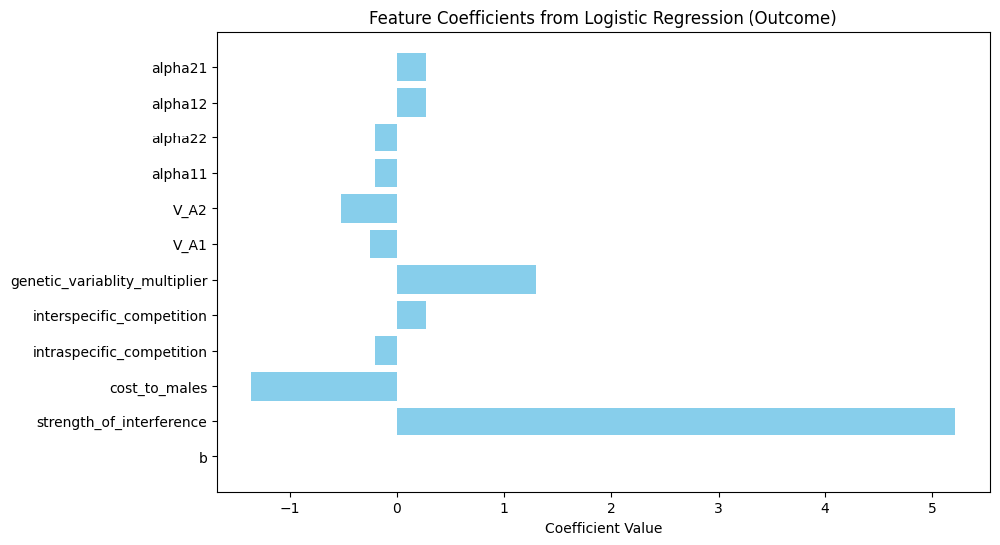

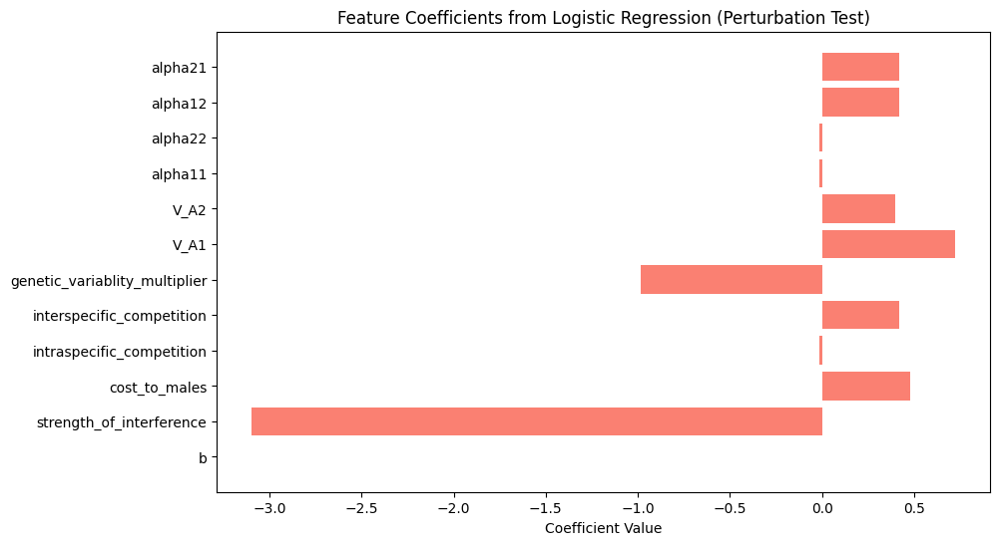

In [7]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, accuracy_score
import matplotlib.pyplot as plt

# Load the perturbation test results Excel file
perturbation_test_results = pd.ExcelFile('perturbation_test_results.xlsx')

# Concatenate all sheets into a single DataFrame
all_sheets_df = pd.concat([pd.read_excel(perturbation_test_results, sheet_name=sheet) for sheet in perturbation_test_results.sheet_names])

# Fill missing values
all_sheets_df = all_sheets_df.fillna(0)

# Ensure columns are of type str where necessary
all_sheets_df['outcome'] = all_sheets_df['outcome'].astype(str)
all_sheets_df['perturbation_test'] = all_sheets_df['perturbation_test'].astype(str)

# Encode the target variables for outcomes
outcome_encoder = LabelEncoder()
all_sheets_df['outcome_encoded'] = outcome_encoder.fit_transform(all_sheets_df['outcome'])

# Prepare features and target for the outcome prediction
X_outcome = all_sheets_df.drop(columns=['outcome', 'outcome_encoded', 'perturbation_test'])
y_outcome = all_sheets_df['outcome_encoded']

# Split the data into training and testing sets
X_train_outcome, X_test_outcome, y_train_outcome, y_test_outcome = train_test_split(X_outcome, y_outcome, test_size=0.3, random_state=42)

# Train the logistic regression model for outcomes
log_reg_outcome = LogisticRegression(max_iter=1000, random_state=42)
log_reg_outcome.fit(X_train_outcome, y_train_outcome)

# Predict on the test set for outcomes
y_pred_outcome = log_reg_outcome.predict(X_test_outcome)

# Evaluate the model for outcomes
accuracy_outcome = accuracy_score(y_test_outcome, y_pred_outcome)
report_outcome = classification_report(y_test_outcome, y_pred_outcome, target_names=outcome_encoder.classes_)

print(f"Logistic Regression Model Accuracy (Outcome): {accuracy_outcome:.2f}")
print("Classification Report (Outcome):")
print(report_outcome)

# Encode perturbation test results as target
perturbation_encoder = LabelEncoder()
all_sheets_df['perturbation_test_encoded'] = perturbation_encoder.fit_transform(all_sheets_df['perturbation_test'])

# Prepare features and target for perturbation test prediction
X_perturbation = all_sheets_df.drop(columns=['outcome', 'outcome_encoded', 'perturbation_test', 'perturbation_test_encoded'])
y_perturbation = all_sheets_df['perturbation_test_encoded']

# Split the data into training and testing sets
X_train_perturbation, X_test_perturbation, y_train_perturbation, y_test_perturbation = train_test_split(X_perturbation, y_perturbation, test_size=0.3, random_state=42)

# Train the logistic regression model for perturbation tests
log_reg_perturbation = LogisticRegression(max_iter=1000, random_state=42)
log_reg_perturbation.fit(X_train_perturbation, y_train_perturbation)

# Predict on the test set for perturbation tests
y_pred_perturbation = log_reg_perturbation.predict(X_test_perturbation)

# Evaluate the model for perturbation tests
accuracy_perturbation = accuracy_score(y_test_perturbation, y_pred_perturbation)
report_perturbation = classification_report(y_test_perturbation, y_pred_perturbation, target_names=perturbation_encoder.classes_)

print(f"Logistic Regression Model Accuracy (Perturbation Test): {accuracy_perturbation:.2f}")
print("Classification Report (Perturbation Test):")
print(report_perturbation)

# Optional: Coefficients visualization for outcome prediction
coefficients_outcome = log_reg_outcome.coef_[0]
features_outcome = X_outcome.columns
plt.figure(figsize=(10, 6))
plt.barh(features_outcome, coefficients_outcome, color='skyblue')
plt.xlabel('Coefficient Value')
plt.title('Feature Coefficients from Logistic Regression (Outcome)')
plt.show()

# Optional: Coefficients visualization for perturbation test prediction
coefficients_perturbation = log_reg_perturbation.coef_[0]
features_perturbation = X_perturbation.columns
plt.figure(figsize=(10, 6))
plt.barh(features_perturbation, coefficients_perturbation, color='salmon')
plt.xlabel('Coefficient Value')
plt.title('Feature Coefficients from Logistic Regression (Perturbation Test)')
plt.show()
